In [10]:

def readFile(fileName):
    fileObj = open(fileName, "r") 
    urls = fileObj.read().splitlines() 
    fileObj.close()
    return urls

def feature_data(dataset_name):
    if dataset_name == 'coco':
        surfboard = dict()
        car = dict()
        refrigerator = dict()

        surfboard['man_object'] = readFile('coco_test/surfboard_man.txt')
        surfboard['woman_object'] = readFile('coco_test/surfboard_woman.txt')
        surfboard['object'] = readFile('coco_test/surfboard.txt')
        
        car['man_object'] = readFile('coco_test/car_man.txt')
        car['woman_object'] = readFile('coco_test/car_woman.txt')
        car['object'] = readFile('coco_test/car.txt')
        
        refrigerator['man_object'] = readFile('coco_test/refrigerator_man.txt')
        refrigerator['woman_object'] = readFile('coco_test/refrigerator_woman.txt')
        refrigerator['object'] = readFile('coco_test/refrigerator.txt')

        random_loaded = readFile('coco_test/random.txt')
        man = readFile('coco_test/man.txt')
        woman = readFile('coco_test/woman.txt')
        stop_sign = readFile('coco_test/stop_sign.txt')
    elif dataset_name == 'openimages':
        surfboard = dict()
        car = dict()
        refrigerator = dict()

        surfboard['man_object'] = readFile('openimages_test/surfboard_man.txt')
        surfboard['woman_object'] = readFile('openimages_test/surfboard_woman.txt')
        surfboard['object'] = readFile('openimages_test/surfboard.txt')
        
        car['man_object'] = readFile('openimages_test/car_man.txt')
        car['woman_object'] = readFile('openimages_test/car_woman.txt')
        car['object'] = readFile('openimages_test/car.txt')
        
        refrigerator['man_object'] = readFile('openimages_test/refrigerator_man.txt')
        refrigerator['woman_object'] = readFile('openimages_test/refrigerator_woman.txt')
        refrigerator['object'] = readFile('openimages_test/refrigerator.txt')

        random_loaded = readFile('openimages_test/random.txt')
        man = readFile('openimages_test/man.txt')
        woman = readFile('openimages_test/woman.txt')
        stop_sign = readFile('openimages_test/stop_sign.txt')
    else:
        print(dataset_name + " not implemented")
    return surfboard, car, refrigerator, random_loaded, man, woman, stop_sign

In [18]:
surfboard, car, refrigerator, random_loaded, man_background, woman_background, stop_sign = feature_data('openimages')

In [1]:
from __future__ import print_function
from __future__ import division
import subprocess
import numpy as np
import json, os, sys, random, pickle
import torchvision.datasets as dset
from torchvision import transforms 
import os
import skimage
#import IPython.display
#import matplotlib.pyplot as plt
from PIL import Image
import urllib
from collections import OrderedDict
import torchvision.datasets as dset
from torchvision import transforms 
from torchvision.transforms import Compose, Resize, CenterCrop, ToTensor, Normalize
import skimage
import IPython.display
import urllib
from collections import OrderedDict
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
import torch.optim as optim
import torchvision
from torchvision import datasets, models, transforms
import time
import copy
import tqdm
from sklearn.metrics import average_precision_score
from sklearn.metrics import f1_score
from sklearn import metrics
from sklearn.metrics import accuracy_score
import clip
#from skimage import io
from pycocotools.coco import COCO
from sklearn.preprocessing import StandardScaler

import torch

In [22]:
!ls ../VisionResearch/finetuneClip/openimages_dataset/val

anns  anns.zip	__MACOSX  train  val


In [36]:

def process_imgs(list_imgs):
    preprocess = Compose([
        Resize(224, interpolation=Image.BICUBIC),
        CenterCrop(224),
        ToTensor()
    ])
    images = []
    for filename in [filename for filename in list_imgs]:
        if filename.startswith('http'):
            image = preprocess(Image.open(urllib.request.urlopen(filename)).convert("RGB"))
        else:
            image = preprocess(Image.open("../VisionResearch/finetuneClip/openimages_dataset/val/"+filename+'.jpg').convert("RGB"))
        images.append(image) 
    return images

surfboard_man = process_imgs(surfboard['man_object'])

In [33]:
def process_imgs(directory):
    preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),])
    images_stacked = []

    for filename in directory:
        if filename.startswith('http'):
            input_image = Image.open(urllib.request.urlopen(filename)).convert("RGB")
        else:
            input_image = Image.open("../VisionResearch/finetuneClip/openimages_dataset/val/"+filename+'.jpg').convert("RGB")
        input_tensor = preprocess(input_image)
        images_stacked.append(input_tensor)
    return torch.tensor(torch.stack(images_stacked,0))

In [34]:
testt = process_imgs(surfboard['man_object'])

/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:16: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  app.launch_new_instance()


In [35]:
testt.shape

torch.Size([25, 3, 224, 224])

# Timing Coco vs Openimages

In [1]:
!ls ../VisionResearch/finetuneClip/openimages_dataset/train/


000002b66c9c498e.jpg  4cfb4968b1b812ac.jpg  a4ccdf85868d92b8.jpg
000002b97e5471a0.jpg  4cfb55231a55713b.jpg  a4cce6ab4d2ac54d.jpg
000002c707c9895e.jpg  4cfb5b882ad37e85.jpg  a4ccea7554e5272e.jpg
0000048549557964.jpg  4cfb7044a06adb8f.jpg  a4cced6388708c29.jpg
000004f4400f6ec5.jpg  4cfb72ffc219c8b8.jpg  a4ccf66dc035d303.jpg
0000071d71a0a6f6.jpg  4cfb73eb1431f32d.jpg  a4ccfd91c7fa125b.jpg
000013ba71c12506.jpg  4cfb9e186f9ae1b2.jpg  a4cd0d8cc25d4c9d.jpg
000018acd19b4ad3.jpg  4cfba34c69afcbdc.jpg  a4cd192dcd4f9126.jpg
00001bc2c4027449.jpg  4cfba431ba96d514.jpg  a4cd2cee1bd18ca7.jpg
00001bcc92282a38.jpg  4cfbab0893c96eaf.jpg  a4cd3d27a89c7576.jpg
0000201cd362f303.jpg  4cfbb2d37f516e38.jpg  a4cd467f6507f067.jpg
000020780ccee28d.jpg  4cfbbb700e651135.jpg  a4cd52a4b140f08b.jpg
000023aa04ab09ed.jpg  4cfbcae9bebe4da6.jpg  a4cd563c943ef246.jpg
0000253ea4ecbf19.jpg  4cfbcaec6862281b.jpg  a4cd5adec59feeb0.jpg
000025ea48cab6fc.jpg  4cfbcbfdbbb86996.jpg  a4cd660558c0742a.jpg
0000271195f2c007.jpg  4cf

00150e2cbc834df9.jpg  4d588d859353a350.jpg  a52b0f1b8ac50951.jpg
00150e654b054faa.jpg  4d58a1b0e039302e.jpg  a52b1dd378e040e7.jpg
001510a63ccce16d.jpg  4d58d09dcaec8417.jpg  a52b2c619c85cef9.jpg
00151191be09d864.jpg  4d58d88d902506fe.jpg  a52b3bf136cab8ea.jpg
001512d120e1e800.jpg  4d58db45c0824531.jpg  a52b4ab62e8117be.jpg
00151646f45da19b.jpg  4d58ddd2f651a840.jpg  a52b4df32d51d468.jpg
00151a35e5fe4d4b.jpg  4d58e7306ba7b5c2.jpg  a52b4f792967289e.jpg
00151a36023916f0.jpg  4d58e89479cfaec8.jpg  a52b5250498a078d.jpg
00151debbf4af26d.jpg  4d58f4cfa6a89e5d.jpg  a52b5679a2deb3db.jpg
00152547e6170b61.jpg  4d58f877a23ccf19.jpg  a52b60988f815615.jpg
0015269d6bf51e88.jpg  4d58fb1b03a81a7b.jpg  a52b7328813ac1bd.jpg
00152aa2004087a9.jpg  4d5906814900f5ae.jpg  a52b7644c4bd47f3.jpg
00152cf562666400.jpg  4d5914eb0ac2fcd6.jpg  a52b8e85557ef107.jpg
00152d67a823ac8a.jpg  4d592a50ab6b401e.jpg  a52b9402ba4fe6b6.jpg
00152da819c824d4.jpg  4d592b42bf209009.jpg  a52ba6e72d6049f8.jpg
00153650edd66db4.jpg  4d5

0053ceb9ccc3e39a.jpg  4e33f4e775cbc9a0.jpg  a60a722e07c0e976.jpg
0053d29a7c0a2938.jpg  4e33f69eb94ea567.jpg  a60a78973d5823c0.jpg
0053d5328e71706d.jpg  4e33fd6f58f825a3.jpg  a60a8649844f0e4d.jpg
0053d6e88f36b7b3.jpg  4e3401dedd295e3b.jpg  a60a89217674c4b8.jpg
0053d7aebcf3903f.jpg  4e340a8fe2b1d746.jpg  a60a8e1754da8ad9.jpg
0053e3681978d26a.jpg  4e343610eac725b4.jpg  a60a90a1c56d3e65.jpg
0053e4fc02b27650.jpg  4e343de6f27eb50a.jpg  a60a9724e7f6310e.jpg
0053e58d7bb8f4d2.jpg  4e344a911dd7397e.jpg  a60a97feaed82e38.jpg
0053e5fe30ca37ef.jpg  4e344aca395df513.jpg  a60a99e4f6dff0d7.jpg
0053eaad1ba9940d.jpg  4e346d8c2860828f.jpg  a60ab0f114e4b32d.jpg
0053edbb78f27798.jpg  4e346e87dadc8fa2.jpg  a60acbddadb8f611.jpg
0053edd6c352d0f1.jpg  4e3475a4e674f6a4.jpg  a60ad758f74c255e.jpg
0053f472bc37e550.jpg  4e3479dff1bc41a7.jpg  a60ae7e16b6c9a3f.jpg
0053f4f3a2740a57.jpg  4e347a96eda816bc.jpg  a60afaecbfee6449.jpg
0053f8dc9abc7805.jpg  4e347e216f94deca.jpg  a60b056224c709c2.jpg
0053ff0fc4d2a3bd.jpg  4e3

008b6a82d34b59c5.jpg  4ed48b7110fc3ef2.jpg  a6b7775b00cbcb0f.jpg
008b6aadc469b3b8.jpg  4ed49cd4b5e752e1.jpg  a6b7784ab0c48e8b.jpg
008b6bbf563a70ed.jpg  4ed49fad32991135.jpg  a6b778ff369be451.jpg
008b6fe4101cbd99.jpg  4ed4a253bfe2d7e6.jpg  a6b7797e17e13553.jpg
008b71fc78a5c82d.jpg  4ed4a319a23bd7e1.jpg  a6b781207311b0e3.jpg
008b726d2abe8a3c.jpg  4ed4a32e49d17b26.jpg  a6b78a943857629a.jpg
008b782aeb480ec4.jpg  4ed4af000edf3eab.jpg  a6b7a427f90d9e24.jpg
008b7c52a28a3dcd.jpg  4ed4b433902e274b.jpg  a6b7ba33631dd011.jpg
008b7daf18c2bd65.jpg  4ed4b72e6f4f153e.jpg  a6b7bf4b28529174.jpg
008b80b929961d67.jpg  4ed4bda91792a6c4.jpg  a6b7c378e8d249b2.jpg
008b84047ab633d6.jpg  4ed4c5bef3443de7.jpg  a6b7cfe4c5a7b621.jpg
008b8556a73601ae.jpg  4ed503df8bd1e058.jpg  a6b7ef0ba36d8db8.jpg
008b85f960b9cd82.jpg  4ed509a85917578c.jpg  a6b7ef748d7144b0.jpg
008b8bb34772d8ae.jpg  4ed50ecaeb60e05f.jpg  a6b7fc11c1c5e951.jpg
008b8e4be9f6c766.jpg  4ed518e580a8fdec.jpg  a6b7fd643e17a217.jpg
008ba056479ad298.jpg  4ed

00dfa8539ec92907.jpg  4fa6bb1c4f377714.jpg  a78f9f272a8aeadf.jpg
00dfb15c470ad7ef.jpg  4fa6c4a7e76ed70b.jpg  a78fa78c98c38b7c.jpg
00dfbe9fe376ea0f.jpg  4fa6e0dded7e0710.jpg  a78fac5b6c52bf77.jpg
00dfbf5429560ff3.jpg  4fa6e51e5ac1734b.jpg  a78fac95f3e6ebd1.jpg
00dfc79e002d7ee3.jpg  4fa6e788d17317ee.jpg  a78fad1e0561bf00.jpg
00dfcd2a2b354ca2.jpg  4fa6e9eb50678f9e.jpg  a78fb22fddaea204.jpg
00dfce665f139242.jpg  4fa6ec9e80dd5a82.jpg  a78fc07a5404df08.jpg
00dfd888871f354a.jpg  4fa6ffa137640bb0.jpg  a78fd648df08854a.jpg
00dfda8574f2f493.jpg  4fa7129545798455.jpg  a78fd898ead860df.jpg
00dfda92ea2cd38d.jpg  4fa71dc4b47cb020.jpg  a78fd9f1079aac47.jpg
00dfdaf6a6d87373.jpg  4fa72e586a9e16ce.jpg  a78ff29bd1965028.jpg
00dfdbd6d2e19b7a.jpg  4fa7324385bf3d11.jpg  a78ffd39ae40fe2e.jpg
00dfe16d0ee1a27b.jpg  4fa7360bb796e52c.jpg  a78ffd5fdb743868.jpg
00dfe333d5a4b7c8.jpg  4fa74455b861e3af.jpg  a78ffe805ec7c625.jpg
00dfe50611bf0328.jpg  4fa745abf3c6345e.jpg  a790115ed7226b2a.jpg
00dfe9c51853568c.jpg  4fa

0129b344aa4f90db.jpg  504eae520ef567ae.jpg  a837fc7d27841a8c.jpg
0129baa4092c52b5.jpg  504eae68ac76f7c8.jpg  a8380066caaa4bae.jpg
0129bb8d6c18ea01.jpg  504eb065af295a50.jpg  a838075424ce2fb4.jpg
0129c14c3c114490.jpg  504ec177c0b975fa.jpg  a83820f7a18b66a9.jpg
0129c15792c61ea9.jpg  504ec73d89c02f14.jpg  a838278656754b50.jpg
0129c4c9edef086e.jpg  504ecf8fd5b3e844.jpg  a83831f833b819b6.jpg
0129c4e9b86f518e.jpg  504ed83d6a627678.jpg  a83833cf729f543e.jpg
0129caf80b554b30.jpg  504ee48d16b666ce.jpg  a838634912d88969.jpg
0129cbfd5684687c.jpg  504eee1374bacb0a.jpg  a838675ec05a65b1.jpg
0129cd3b925373ed.jpg  504ef31704b23cc7.jpg  a838700f31013c46.jpg
0129d29b15e8792e.jpg  504ef429daede29b.jpg  a83871f97911ace2.jpg
0129d889de4aed94.jpg  504ef73174adae45.jpg  a8387cbf8861cfab.jpg
0129df3daf3ea1d2.jpg  504ef932e5b87009.jpg  a83882f24a6f37c5.jpg
0129e89f8913ea75.jpg  504f160ec910fe7f.jpg  a83898fdfd41cfa0.jpg
0129f0c8300ce7ce.jpg  504f2916fa9a76a8.jpg  a838c6197350ceb3.jpg
0129f5e3f8236a48.jpg  504

018a2e1dbe91fc46.jpg  510f590737014729.jpg  a90036b5c92a7b09.jpg
018a2fa24fd228c7.jpg  510f83c2d6d1b25e.jpg  a90036f641a62f7f.jpg
018a39b9de49c09d.jpg  510f8939dc909713.jpg  a900393a743710ec.jpg
018a3cf878bc0f23.jpg  510f8ea9507be274.jpg  a90039ba8a060a2e.jpg
018a3e349fa928da.jpg  510f952c224d1b26.jpg  a9003b7703b4101f.jpg
018a477cc989f6cc.jpg  510fa06541c7034c.jpg  a9004074a2cea676.jpg
018a606a8abe140c.jpg  510fbaf88f49e446.jpg  a9004e82b036d7ee.jpg
018a6194a7c3b20e.jpg  510fcad4710ea6b8.jpg  a90052a496702688.jpg
018a61fc20130899.jpg  510fcb5b59b9165a.jpg  a90052b3d6d11d9d.jpg
018a6296fed1f89a.jpg  510fe0a57ea16d71.jpg  a9006657a19b6d09.jpg
018a68fabf5d4f2c.jpg  510fee63a89dc3e4.jpg  a90078b58bdf55d2.jpg
018a6a36ef557133.jpg  51100e0299e668a7.jpg  a9007a6ee13d34db.jpg
018a6c55659ce0cd.jpg  51102ef163a34dd0.jpg  a9009bba564cc048.jpg
018a6cd783c819b7.jpg  51103006d155696c.jpg  a900a7d6c86df7ef.jpg
018a6dfb8b289fc8.jpg  511030d156591690.jpg  a900aa1e7fb1b8a0.jpg
018a74c61f3c1a57.jpg  511

0207d182b0d06be0.jpg  51fa08c6ccbacf51.jpg  a9f3499661b7537c.jpg
0207dc06fbfbe3f8.jpg  51fa25a3b4f11ae3.jpg  a9f351816d820248.jpg
0207e102dbb2b3ea.jpg  51fa28e7f16b3460.jpg  a9f356f24ace5a55.jpg
0207ea1877c62bf1.jpg  51fa3ffb725190af.jpg  a9f357b3def687b0.jpg
0207eae9e68a4b9b.jpg  51fa5622acea1252.jpg  a9f3637dfceeb21e.jpg
0207ec11d473f348.jpg  51fa5c61f93cd05a.jpg  a9f37a5276b56969.jpg
0207f1396e334c2b.jpg  51fa67af56a8fa44.jpg  a9f37fdda353230a.jpg
0207f27abb8c2c15.jpg  51fa68c5dd77e908.jpg  a9f39f188a58f2e0.jpg
0207f552d2c22a6c.jpg  51fa6d1d3d559cc7.jpg  a9f3b1fa9c7caabd.jpg
0207fd3d33dfe223.jpg  51fa713e0939de66.jpg  a9f3c6b828665ddc.jpg
0207fda1fd7e1905.jpg  51fa7694892b3233.jpg  a9f3d5a3b36ba21f.jpg
020802842e1468f8.jpg  51fa82b3f5b95d4e.jpg  a9f3d932b60112e5.jpg
0208031dda5a2e83.jpg  51fa965d346c586e.jpg  a9f3dacf552c7f95.jpg
02080aaf8442c064.jpg  51fa9c06361294fe.jpg  a9f3e9f00c9012fd.jpg
02080baccb392a5a.jpg  51fa9f5f66876bb1.jpg  a9f3f29447cd1cf2.jpg
02080ed78466caa6.jpg  51f

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



9383.jpg
2885fd600dc6eac6.jpg  7f01a9d1e64a078b.jpg  d776fc88fbc14cf9.jpg
28860323cf7d0f50.jpg  7f01ae3a52661980.jpg  d77710b40fc81e7d.jpg
28860690ca9ad97d.jpg  7f01bf253b5a287b.jpg  d777153788afb125.jpg
28860f003d04c88b.jpg  7f01cf747cde858b.jpg  d777181356a489b8.jpg
28861450fdf52f45.jpg  7f01d9052487f73f.jpg  d777260789591566.jpg
28861ab76d1d2086.jpg  7f01e184cb3b7742.jpg  d77728ebe1ea98bf.jpg
28862122c294374a.jpg  7f01ed3b40a98ab5.jpg  d77741a3e4745c73.jpg
28862eeead970411.jpg  7f02063b55dabb62.jpg  d77745b3507a5b48.jpg
288638acf9a60eab.jpg  7f020d7c6647271c.jpg  d777521163bd4d5f.jpg
2886464fa0412d4f.jpg  7f02195f31e2acb7.jpg  d777522497ce06f8.jpg
28865bf43565c9d9.jpg  7f0229b6facd25ca.jpg  d77758a1165ced5f.jpg
2886699ed6095224.jpg  7f0229d34d0808b5.jpg  d7775ef8a868d9a3.jpg
288670d13df648da.jpg  7f0236cf475dd751.jpg  d7776fa996aed441.jpg
28867796f8839373.jpg  7f023d60f45b7b6f.jpg  d77775e3c4cd4081.jpg
28867f928f227f99.jpg  7f02443f3bfbe3db.jpg  d7777f69cecc77ba.jpg
28868e1badd5a71f

2991bf46398e583a.jpg  80180daeca6437c0.jpg  d8923ce4d366dc68.jpg
2991cba3275713ee.jpg  80182c3a2aa865a5.jpg  d8923e05e17645ea.jpg
2991cd7ecbeb3cc9.jpg  8018367d607ecab3.jpg  d892565aec5fcd80.jpg
2991d0f437bb0d68.jpg  801840473413b3e6.jpg  d8926e4eb70b3c46.jpg
2991d4f000ff5756.jpg  8018517dbb06d7a7.jpg  d8927be7563ee76d.jpg
2991dbc35f806ac2.jpg  80185ade53e7b3bb.jpg  d8927c07dcb2a6cf.jpg
2991e1fade802633.jpg  80187c27f49a4e59.jpg  d8927e0f2674d44e.jpg
2991f7a00f36c56c.jpg  801880196508e590.jpg  d8928b66e7014890.jpg
2991f9b8d7c8e396.jpg  8018900528ab7784.jpg  d892a192dc1f24d2.jpg
2991ff4b08cea92e.jpg  80189a94fe721764.jpg  d892afbe2324d927.jpg
299202c6ceb4bf2d.jpg  80189fdbef922305.jpg  d892b389ad2cc77e.jpg
299206e50ddd11fb.jpg  8018a108527a1b85.jpg  d892bde8a8324434.jpg
299215a6d73632c6.jpg  8018afe466de2ed6.jpg  d892cb8c4143e7fb.jpg
29921cc10673f377.jpg  8018b13f1fff2505.jpg  d892deeb925cb3ad.jpg
299231eb20d38f55.jpg  8018b3e119f22d7b.jpg  d892e9dae39f8136.jpg
299237358238c99c.jpg  801

2a9d725489c4140b.jpg  813465a0bc7c2eb6.jpg  d9ac9f3355cf0ace.jpg
2a9d8665e3c1991e.jpg  81347358b1e3b9c2.jpg  d9acadcbbe5ef2c6.jpg
2a9d87a7acdbc81e.jpg  81347688caf0940c.jpg  d9acb6d869d7a67c.jpg
2a9d8a34cac63e2f.jpg  8134818cd60882ec.jpg  d9acb901d7551461.jpg
2a9d99e579c4c2ad.jpg  813482c203eae286.jpg  d9acc267b4bc8da5.jpg
2a9d9ed3546e5d04.jpg  81348aadd494c242.jpg  d9acc6bb055ba425.jpg
2a9dadfc4f53d78c.jpg  8134a03d8efeafba.jpg  d9accfd0a1175f6b.jpg
2a9db7c665723155.jpg  8134aef2fbe9fa4a.jpg  d9acd341f8d77b43.jpg
2a9ddcc29b2852f8.jpg  8134c4fd2d6d3b82.jpg  d9acdde7283d97c6.jpg
2a9de76eb84be588.jpg  81350ec50e09021c.jpg  d9ace057e1f68bff.jpg
2a9de8868c4f1792.jpg  81351374b8631ac8.jpg  d9ace673f5c0eefe.jpg
2a9dfcf0278ede1a.jpg  813523a5757028f6.jpg  d9acf9fe3a541313.jpg
2a9e0bb7b1e2e2c4.jpg  813529296f8c5415.jpg  d9acfe9bcdcb3ec4.jpg
2a9e13dbc70b66a7.jpg  813538a891494d94.jpg  d9ad01be009ab7f9.jpg
2a9e14dee60a7082.jpg  813539f944578b70.jpg  d9ad0a060b6a53ef.jpg
2a9e18d5e178c9ec.jpg  813

2ba52b4668e75812.jpg  824e6ab6a136c023.jpg  dac0a4990e46977c.jpg
2ba533c3f39d0be4.jpg  824e7ed2f7e943fb.jpg  dac0afff60c31668.jpg
2ba534bf94bb6b5f.jpg  824e8114ff66d705.jpg  dac0bb5fa206ceef.jpg
2ba542f646a58fd6.jpg  824e86b3c0c1aabe.jpg  dac0c8032ecb7b6a.jpg
2ba547a648b01738.jpg  824e8b949d9c5936.jpg  dac0ca2599ea34b6.jpg
2ba54d797b890d5e.jpg  824e9d1e61d7fbd9.jpg  dac0d9369d3f5b59.jpg
2ba55bf537e4f505.jpg  824ea0816b8e2bf7.jpg  dac0dfa014fc73e8.jpg
2ba560945ec5ecb3.jpg  824ea3153b93bf63.jpg  dac0e2de5529d21e.jpg
2ba565a703b86aaa.jpg  824eb1915f5b6a00.jpg  dac0e7c71d492f24.jpg
2ba5783cd309f0de.jpg  824eb1ee6da36514.jpg  dac0f58d6626746e.jpg
2ba5798c25cbdebb.jpg  824ec614e085a89c.jpg  dac1063a7ec69ba2.jpg
2ba57a3f7743d892.jpg  824ecfafaeb6c9c7.jpg  dac10e2e4b7fb978.jpg
2ba58027bc322121.jpg  824ee556b8a4e7ec.jpg  dac1123449ba07cf.jpg
2ba58ac3e7717fcd.jpg  824ee8f3a5e38b62.jpg  dac11fc61646f95d.jpg
2ba5924c571bdc26.jpg  824efc0875631b2a.jpg  dac1247337d76f6c.jpg
2ba593f5ab754174.jpg  824

2cae01ba672f36eb.jpg  8365314e480775e2.jpg  dbdc90e3552350c5.jpg
2cae04721ee17dba.jpg  836531d34fc7703b.jpg  dbdc9f2267d25705.jpg
2cae14591efd18fa.jpg  83653e40cb93edb3.jpg  dbdca53600febd98.jpg
2cae15bbc33fe8ad.jpg  836541b49a1d2414.jpg  dbdcac14eb0c48b6.jpg
2cae16bd876e2bc0.jpg  83655308d5cabb3d.jpg  dbdcb1200531279f.jpg
2cae2a5145cd0158.jpg  83655bb920755e79.jpg  dbdcb4ae725d5a46.jpg
2cae2f3baeb13f24.jpg  83655d030f96ef4a.jpg  dbdcbe8d414088d4.jpg
2cae367109cd176f.jpg  8365603a534dacea.jpg  dbdcc9b3df79344c.jpg
2cae408be9fa1749.jpg  83656897b28798dd.jpg  dbdcf5ca61fa2427.jpg
2cae57c1bf7435fd.jpg  83657055972c3359.jpg  dbdcfd3d4a7d94f7.jpg
2cae5fa791e7d30e.jpg  8365760299178f19.jpg  dbdd0972d46f45cb.jpg
2cae65ed9b03a39c.jpg  836579ac31a62002.jpg  dbdd1dd7111681ff.jpg
2cae6777545f740c.jpg  8365b29d749b2351.jpg  dbdd21224db7c3bf.jpg
2cae6a03f6e6fc45.jpg  8365c3b7f8300ef0.jpg  dbdd2e0e7d0d5957.jpg
2cae6ce721c84246.jpg  8365c9ec1dd22b42.jpg  dbdd3aa41913706b.jpg
2cae724bea770e79.jpg  836

2db4e1b3e082dc6d.jpg  846f73496570e294.jpg  dcea6011c4cc9740.jpg
2db4eff3174a528e.jpg  846f7e64aa1c3d9b.jpg  dcea61d34d24350d.jpg
2db4fa787039b55a.jpg  846f81d15d7d0411.jpg  dcea62e7c6130cca.jpg
2db50436cb7ea9ef.jpg  846f8d20b1a0aa44.jpg  dcea677cb7b7f0f0.jpg
2db505a3d2d2be08.jpg  846f989cf23d7225.jpg  dcea73bcbd64eaf0.jpg
2db50c5683987f7c.jpg  846f9bf516a54f48.jpg  dcea74859b391d85.jpg
2db512bdce99a625.jpg  846f9efec5db1a79.jpg  dcea868684fd2800.jpg
2db51548f4aaa938.jpg  846fa5b04b94dad6.jpg  dceaa1c2cce5f985.jpg
2db520adaf9c4619.jpg  846faf66775c3792.jpg  dceaaae29e741a98.jpg
2db52c2680ae2046.jpg  846fb96beeef4de7.jpg  dceab26ec2bed385.jpg
2db52cbf0ff18d28.jpg  846fbcbc223b2f6e.jpg  dceabfd24121b4e3.jpg
2db52e32e0379f70.jpg  846fbdd981a0b5bb.jpg  dceaddda910c2a58.jpg
2db531e47aba1c66.jpg  846fc828d58b6477.jpg  dceaec9d14811a67.jpg
2db538c4fd608688.jpg  846fd38b9a94b948.jpg  dceaf68b5631c705.jpg
2db54577d8fc97cd.jpg  846fd669965ce812.jpg  dceb1173c97c7c6d.jpg
2db54bfc279780f0.jpg  846

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Text(0, 0.5, 'Time')

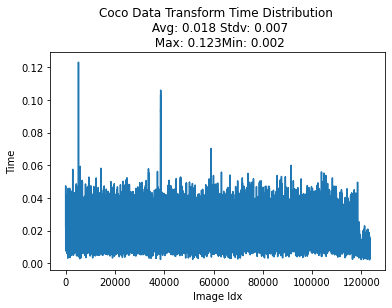

In [67]:
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np 

with open('coco_times.txt') as f:
    lines = f.readlines()
lines = [float(line.strip()) for line in lines]
avg_time = np.mean(lines).round(3)
max_time = np.max(lines).round(3)
min_time = np.min(lines).round(3)
std_time = np.std(lines).round(3)
plt.plot(np.arange(len(lines)), lines)
plt.title("Coco Data Transform Time Distribution \n Avg: "+ str(avg_time) + " Stdv: " + str(std_time) + "\n Max: " + str(max_time) + "Min: " + str(min_time))
plt.xlabel("Image Idx")
plt.ylabel("Time")


In [2]:
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np

with open('openimages_times.txt') as f:
    lines = f.readlines()
lines = [float(line.strip()) for line in lines]

avg_time = np.mean(lines).round(3)
max_time = np.max(lines).round(3)
min_time = np.min(lines).round(3)
std_time = np.std(lines).round(3)
plt.plot(np.arange(len(lines)), lines)
plt.title("Openimages Data Transform Time Distribution \n Avg: "+ str(avg_time) + " Stdv: " + str(std_time) + "\n Max: " + str(max_time) + " Min: " + str(min_time))
plt.xlabel("Image Idx")
plt.ylabel("Time")

NameError: name 'np' is not defined

Text(0, 0.5, 'Time')

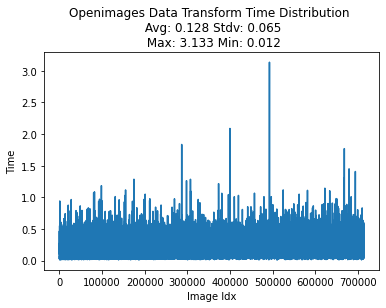

In [14]:
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
avg_time = np.mean(lines).round(3)
max_time = np.max(lines).round(3)
min_time = np.min(lines).round(3)
std_time = np.std(lines).round(3)
plt.plot(np.arange(len(lines)), lines)
plt.title("Openimages Data Transform Time Distribution \n Avg: "+ str(avg_time) + " Stdv: " + str(std_time) + "\n Max: " + str(max_time) + " Min: " + str(min_time))
plt.xlabel("Image Idx")
plt.ylabel("Time")

In [6]:
import os
from PIL import Image
#coco_trainimgs = os.listdir("/localtmp/data/coco2017/coco_dataset/train2017/train2017") 
#num_coco_train = len(coco_trainimgs)

#coco_valimgs = os.listdir("/localtmp/data/coco2017/coco_dataset/val2017") 
#num_coco_val = len(coco_valimgs)

openimages_trainimgs = os.listdir("../VisionResearch/finetuneClip/openimages_dataset/train")
num_openimages_train = len(openimages_trainimgs)

#openimages_valimgs = os.listdir("../VisionResearch/finetuneClip/openimages_dataset/val")
#num_openimages_val = len(openimages_valimgs)

In [7]:
def calc_img_res(root, imgs):
    all_res = dict()
    width = 0
    height = 0
    
    for img in imgs:
        im = Image.open(root+img)
        res = im.size
        if res not in all_res:
            all_res[res] = 1
        else:
            all_res[res] +=1
        width+=res[0]
        height+=res[1]
    
    avg_width = width / len(imgs)
    avg_height = height / len(imgs)
    return all_res, avg_width, avg_height
    

In [8]:
def calc_percent(img_res, thresh, title):
    sorted_dict = {k: v for k, v in sorted(img_res.items(), key=lambda item: item[1], reverse=True)}
    vals = list(sorted_dict.values())
    keys =  [str(i) for i in list(sorted_dict.keys())]
    sum_vals = np.sum(vals)
    percent = []
    for i in vals:
        percent.append(i/sum_vals)
    
    percent_sum = 0
    count = 0
    while percent_sum < thresh:
        percent_sum+= percent[0]
        count+=1
    plt.xticks(rotation=60, fontsize=10)
    plt.plot(keys[:count], percent[:count])
    plt.title(title + "\n Num sizes: " + str(len(keys)))
    plt.xlabel("Image size")
    plt.ylabel("Percentage of dataset")


In [41]:
cocoval_img_res, cocoval_avg_width, cocoval_avg_height = calc_img_res("/localtmp/data/coco2017/coco_dataset/val2017/", coco_valimgs)

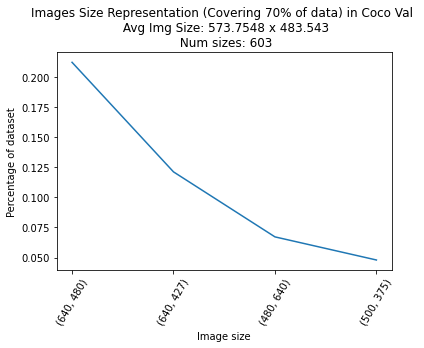

In [97]:
calc_percent(cocoval_img_res, 0.7, "Images Size Representation (Covering 70% of data) in Coco Val \n Avg Img Size: " + str(cocoval_avg_width) + " x " + str(cocoval_avg_height))  

In [44]:
cocotrain_img_res, cocotrain_avg_width, cocotrain_avg_height = calc_img_res("/localtmp/data/coco2017/coco_dataset/train2017/train2017/", coco_trainimgs)

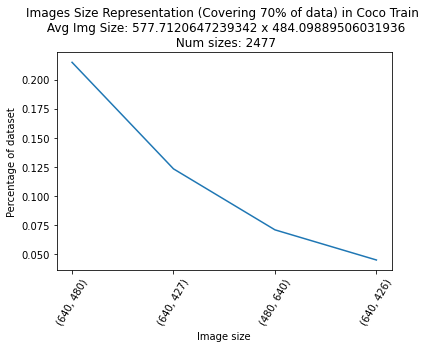

In [101]:
calc_percent(cocotrain_img_res, 0.7, "Images Size Representation (Covering 70% of data) in Coco Train \n Avg Img Size: " + str(cocotrain_avg_width) + " x " + str(cocotrain_avg_height))  

In [45]:
openimagesval_img_res, openimagesval_avg_width, openimagesval_avg_height = calc_img_res("../VisionResearch/finetuneClip/openimages_dataset/val/", openimages_valimgs)


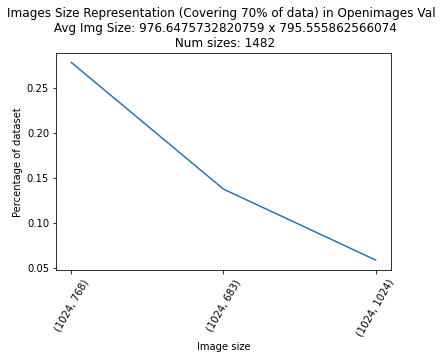

In [99]:
calc_percent(openimagesval_img_res, 0.7, "Images Size Representation (Covering 70% of data) in Openimages Val \n Avg Img Size: " + str(openimagesval_avg_width) + " x " + str(openimagesval_avg_height))  

In [9]:
openimagestrain_img_res, openimagestrain_avg_width, openimagestrain_avg_height = calc_img_res("../VisionResearch/finetuneClip/openimages_dataset/train/", openimages_trainimgs)
# resize so that the longest side to 256 "/data/openimages" on prediction.cs.v

/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:811: UserWarning: Truncated File Read
  warnings.warn(str(msg))


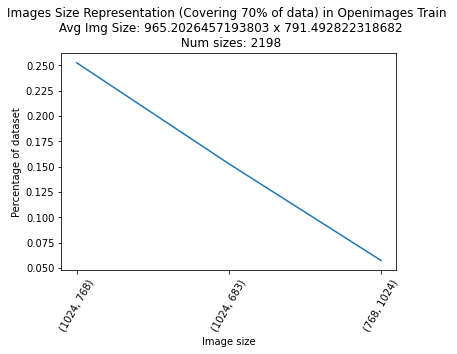

In [10]:
calc_percent(openimagestrain_img_res, 0.7, "Images Size Representation (Covering 70% of data) in Openimages Train \n Avg Img Size: " + str(openimagestrain_avg_width) + " x " + str(openimagestrain_avg_height))  

In [12]:
from itertools import islice

def take(n, iterable):
    "Return first n items of the iterable as a list"
    return list(islice(iterable, n))

In [15]:
sorted_dict = {k: v for k, v in sorted(openimagestrain_img_res.items(), key=lambda item: item[1], reverse=True)}

In [16]:
len(sorted_dict.values())

2198

In [19]:
n_items = take(10, sorted_dict.items())


In [20]:
n_items

[((1024, 768), 440088),
 ((1024, 683), 266369),
 ((768, 1024), 99970),
 ((1024, 1024), 75582),
 ((683, 1024), 62708),
 ((1024, 681), 58933),
 ((1024, 680), 57823),
 ((1024, 682), 44334),
 ((1024, 685), 36595),
 ((1024, 576), 31794)]

# Plot dataset images

In [21]:
Image.open(urllib.request.urlopen(filename)

BiT-M-R50x1.npz  data_loader.py  openimages_test       README.md
coco_test	 model_init.py	 openimages_times.txt  test.ipynb
coco_times.txt	 models		 plots		       train.py
cosine_exp.py	 models_def	 __pycache__


In [13]:
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
from PIL import Image
import os
import urllib.request
def plot_coco(path):
    images = []
    with open(path) as f:
        urls = f.readlines()
    for i in urls:
        images.append(Image.open(urllib.request.urlopen(i)))
    plt.figure(figsize=(20,10))
    columns = 4
    for i, image in enumerate(images):
        plt.subplot(len(images) / columns + 1, columns, i + 1)
        plt.imshow(image)
        plt.xticks([])
        plt.yticks([])

def plot_openimages(path):
    images = []
    with open(path) as f:
        ids = f.readlines()
    for i in ids:
        images.append(Image.open("../../VisionResearch/finetuneClip/openimages_dataset/val/"+i.strip()+'.jpg'))
    plt.figure(figsize=(20,10))
    columns = 10
    print("NUM IMAGES: ", len(images))
    for i, image in enumerate(images[:50]):
        plt.subplot(len(images[:50]) / columns + 1, columns, i + 1)
        plt.imshow(image)
        plt.xticks([])
        plt.yticks([])

In [5]:
!ls ../openimages_test/

car_man.txt	 fashion.txt	    mammal_woman.txt  sports.txt
car.txt		 fashion_woman.txt  man.txt	      sports_woman.txt
car_woman.txt	 mammal_man.txt     random.txt	      stop_sign.txt
fashion_man.txt  mammal.txt	    sports_man.txt    woman.txt


NUM IMAGES:  150


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


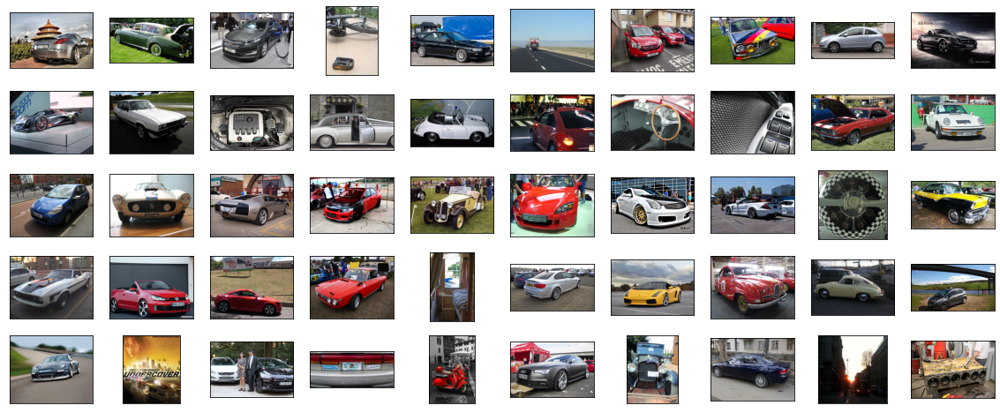

In [14]:
plot_openimages('../openimages_test/car.txt')

NUM IMAGES:  150


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


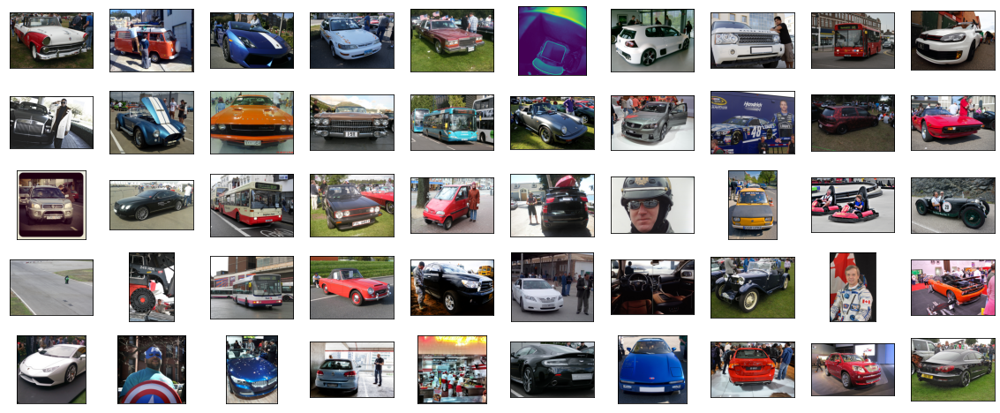

In [15]:
plot_openimages('../openimages_test/car_man.txt')


NUM IMAGES:  49


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


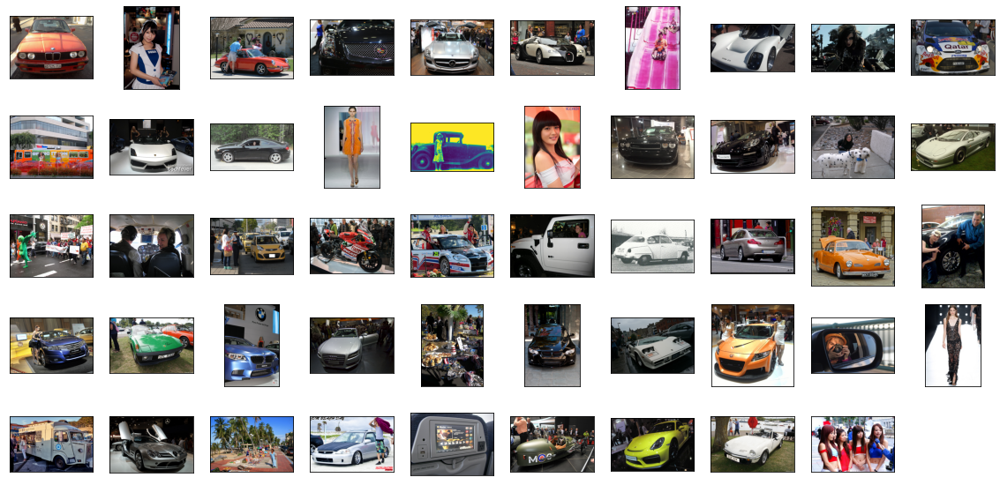

In [17]:
plot_openimages('../openimages_test/car_woman.txt')

NUM IMAGES:  150


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


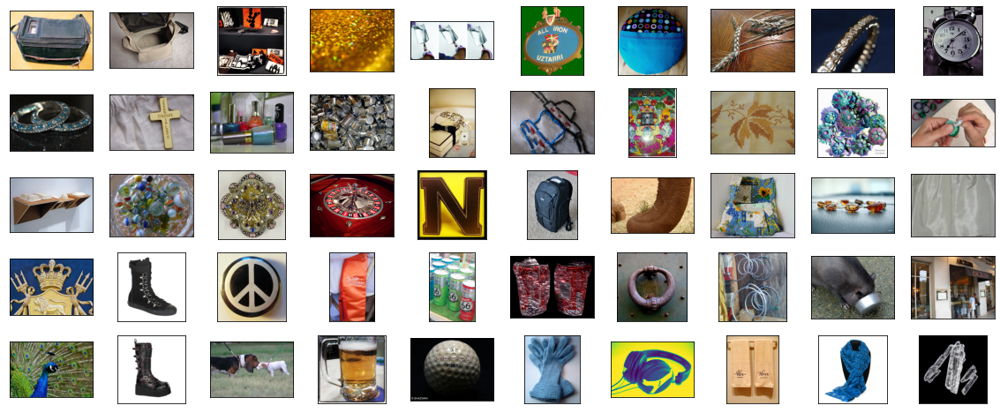

In [18]:
plot_openimages('../openimages_test/fashion.txt')

NUM IMAGES:  150


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


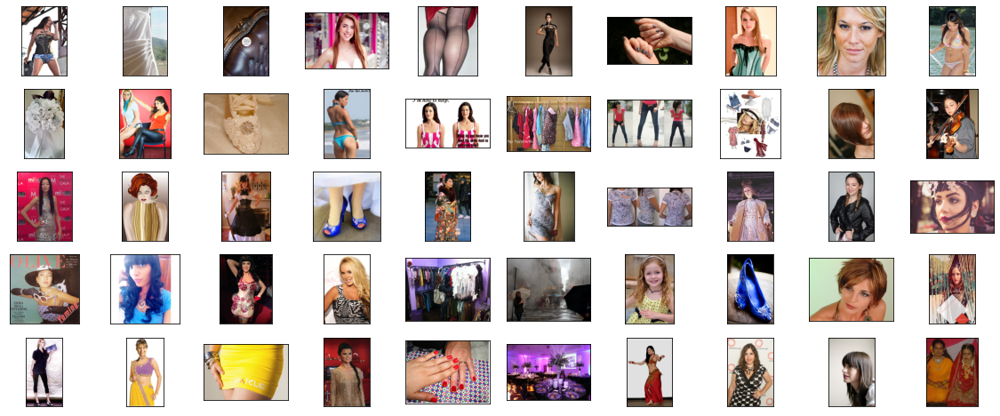

In [19]:
plot_openimages('../openimages_test/fashion_woman.txt')

NUM IMAGES:  52


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


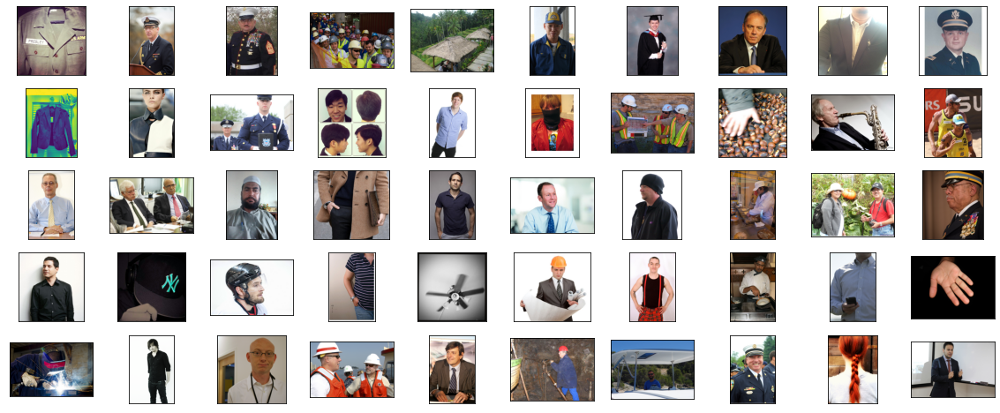

In [20]:
plot_openimages('../openimages_test/fashion_man.txt')

NUM IMAGES:  150


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


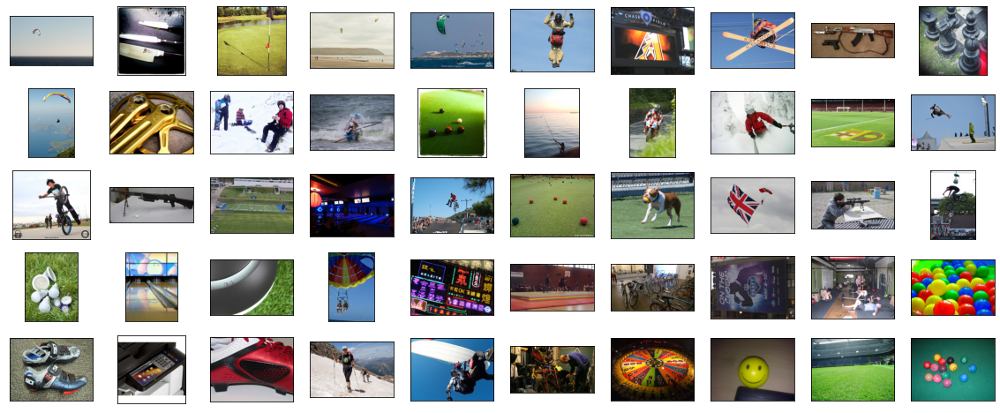

In [22]:
plot_openimages('../openimages_test/sports.txt')

NUM IMAGES:  120


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


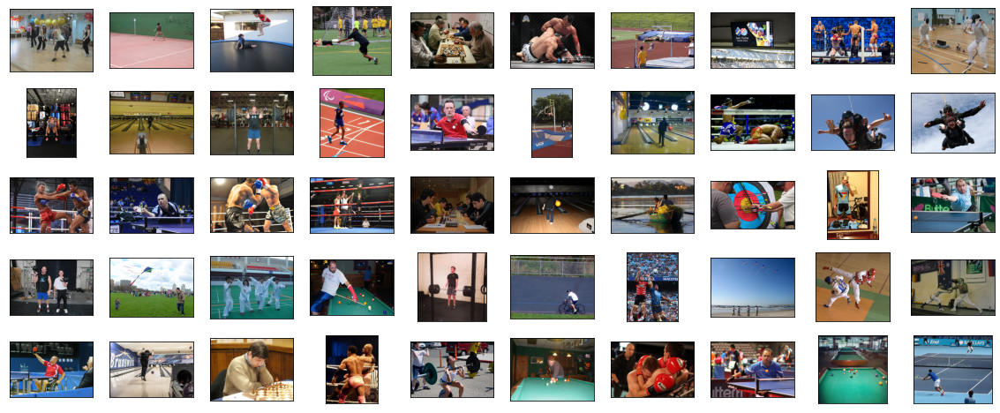

In [23]:
plot_openimages('../openimages_test/sports_man.txt')

NUM IMAGES:  32


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


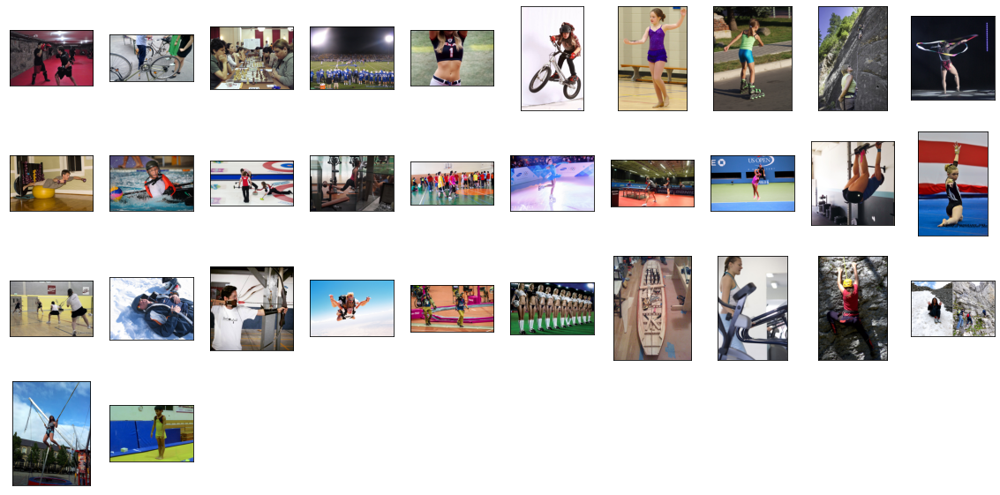

In [24]:
plot_openimages('../openimages_test/sports_woman.txt')

NUM IMAGES:  150


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


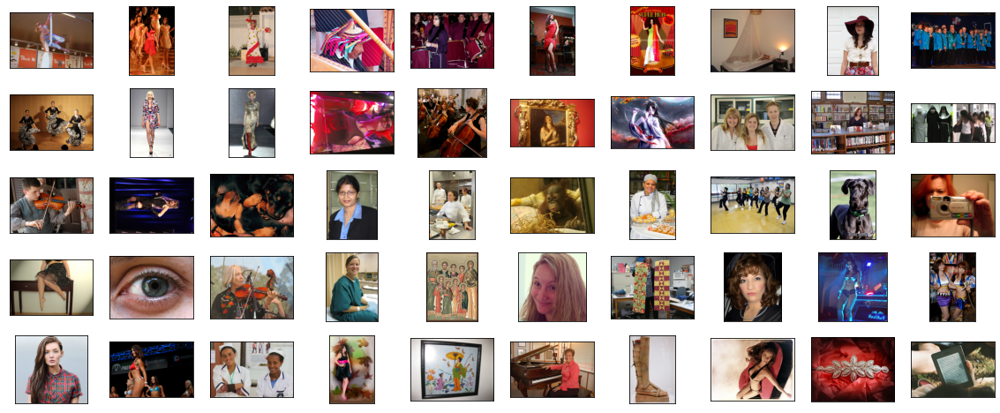

In [26]:
plot_openimages('../openimages_test/woman.txt')

NUM IMAGES:  150


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


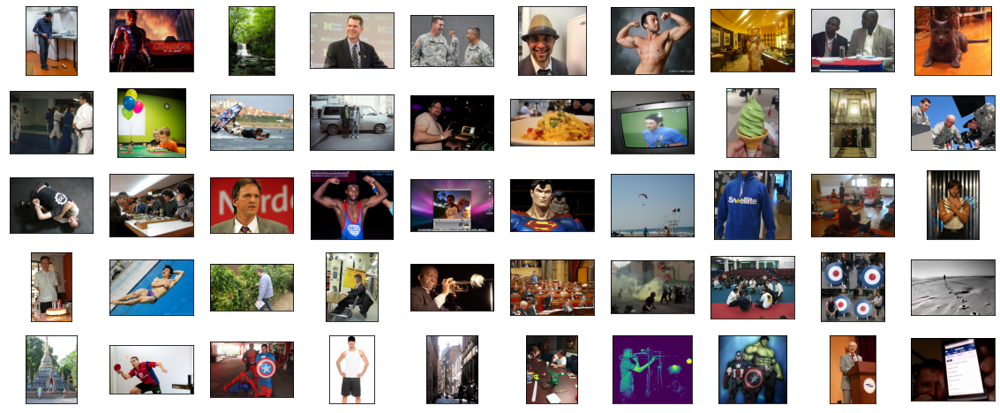

In [25]:
plot_openimages('../openimages_test/man.txt')

NUM IMAGES:  22


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


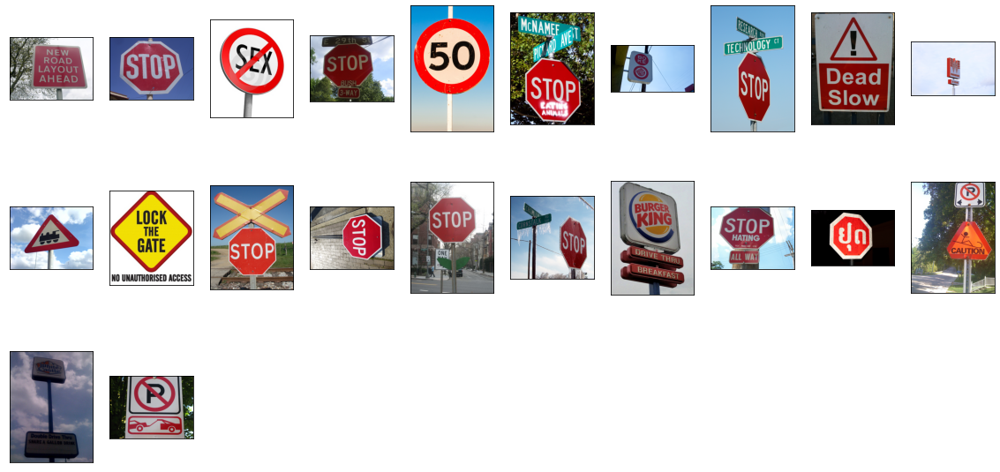

In [28]:
plot_openimages('../openimages_test/stop_sign.txt')

NUM IMAGES:  150


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


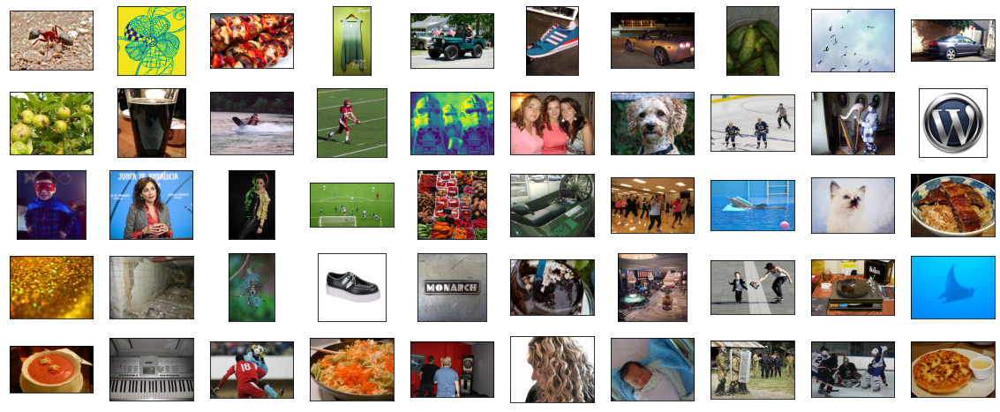

In [30]:
plot_openimages('../openimages_test/random.txt')

NUM IMAGES:  21


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


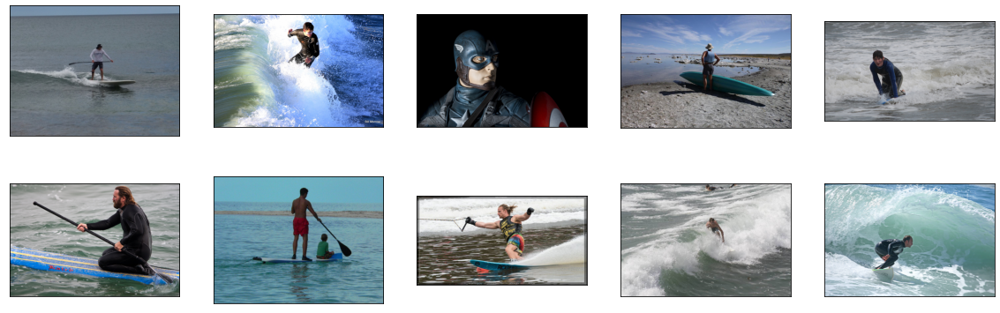

In [8]:
plot_openimages('openimages_test/surfboard_man.txt')

NUM IMAGES:  6


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


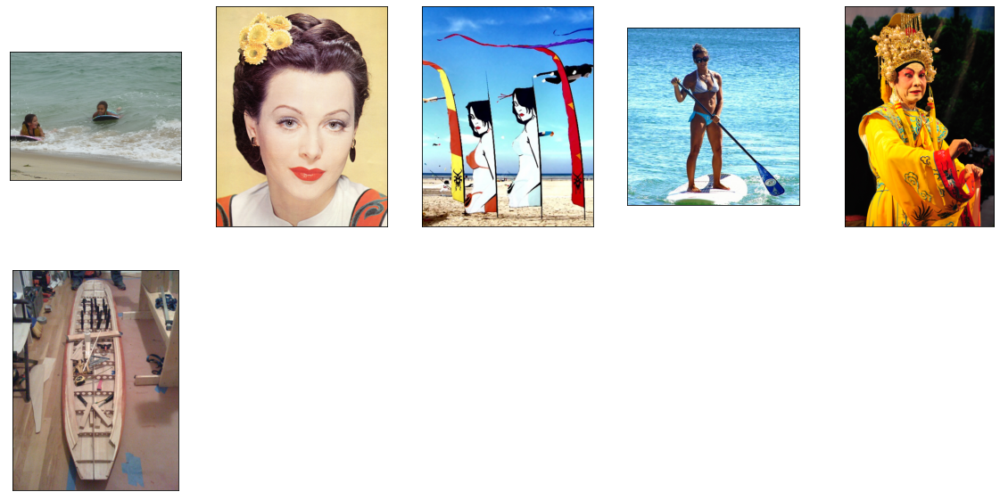

In [9]:
plot_openimages('openimages_test/surfboard_woman.txt')


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:31: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


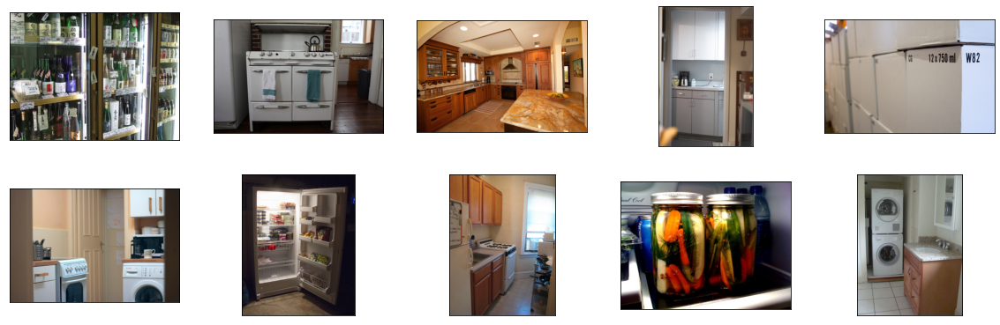

In [13]:
plot_openimages('openimages_test/refrigerator.txt')


In [14]:
plot_openimages('openimages_test/refrigerator_man.txt')


<Figure size 1440x720 with 0 Axes>

In [15]:
plot_openimages('openimages_test/refrigerator_woman.txt')

<Figure size 1440x720 with 0 Axes>

NUM IMAGES:  50


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


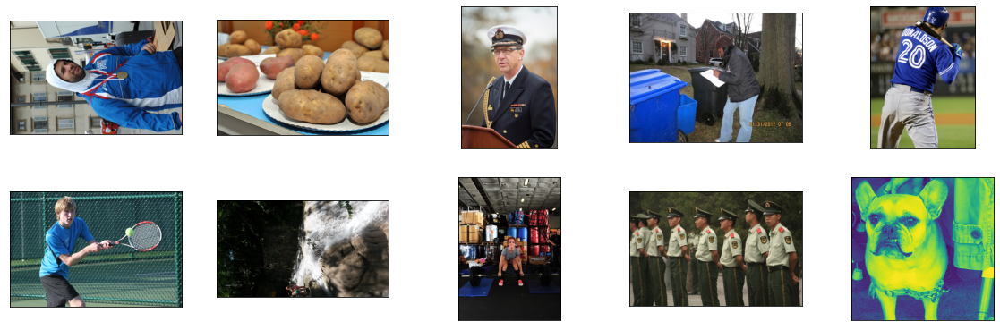

In [10]:
plot_openimages('openimages_test/man.txt')


NUM IMAGES:  50


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


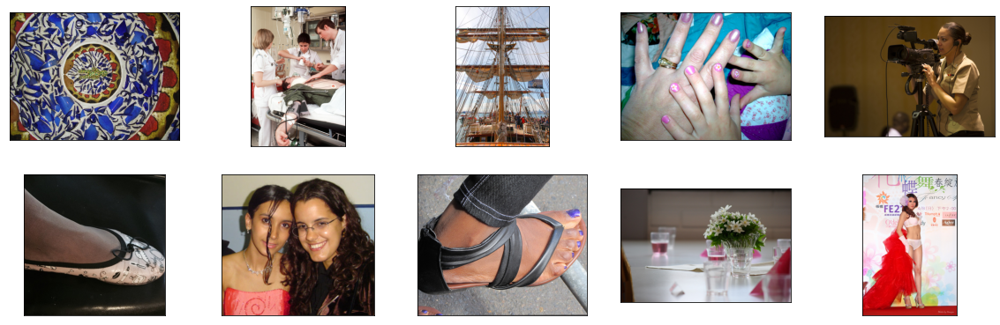

In [11]:
plot_openimages('openimages_test/woman.txt')


NUM IMAGES:  50


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


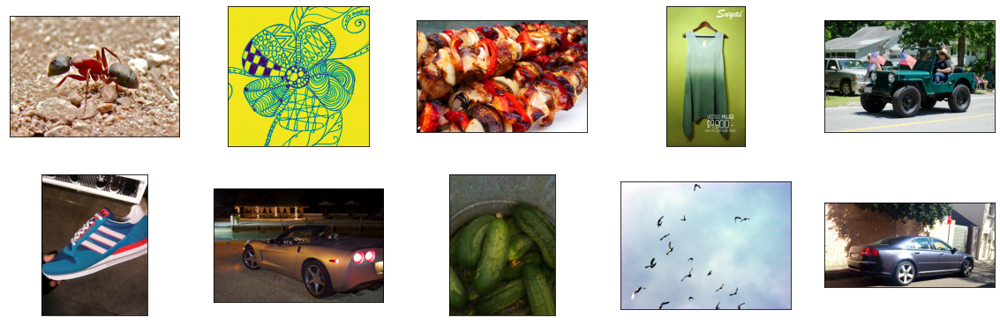

In [12]:
plot_openimages('openimages_test/random.txt')


NUM IMAGES:  23


/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:32: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


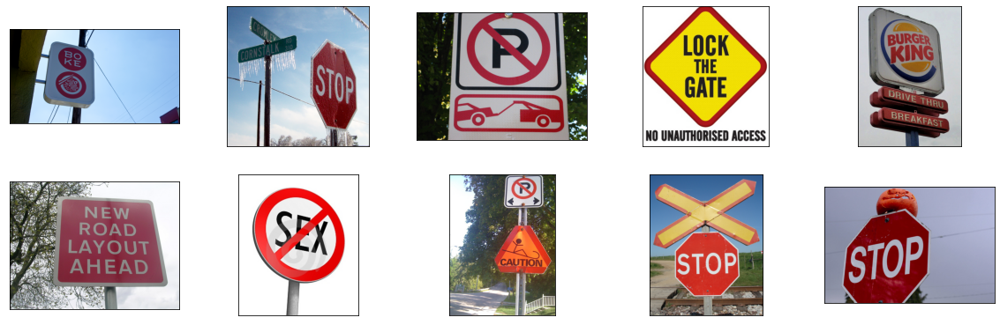

In [13]:
plot_openimages('openimages_test/stop_sign.txt')

/u/lab/jr4fs/anaconda2/envs/coco_exp/lib/python3.6/site-packages/ipykernel_launcher.py:17: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


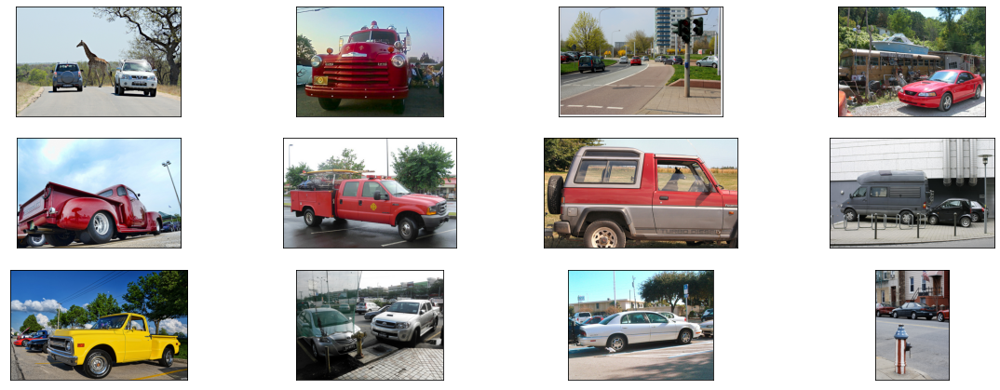

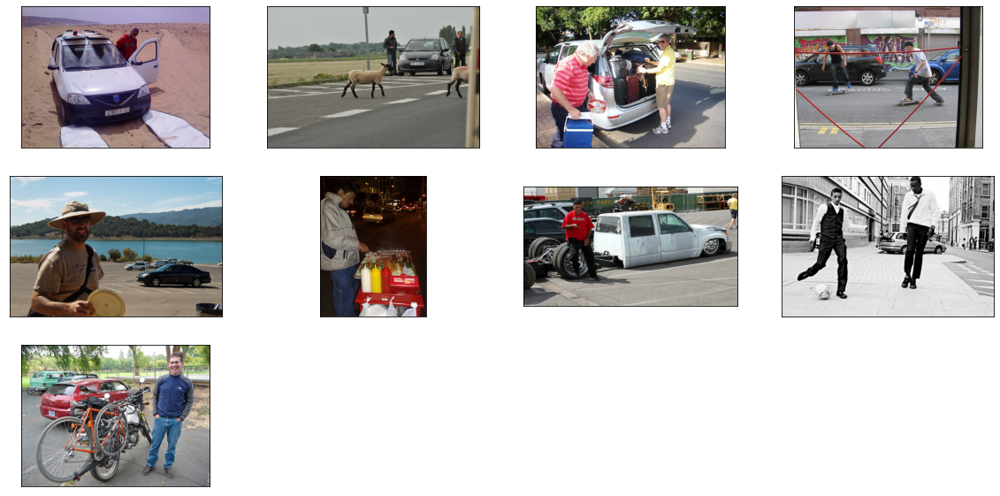

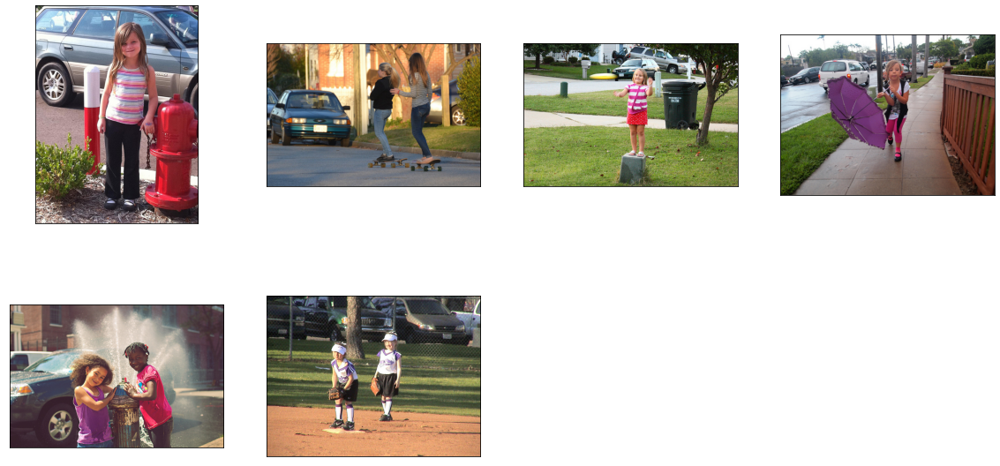

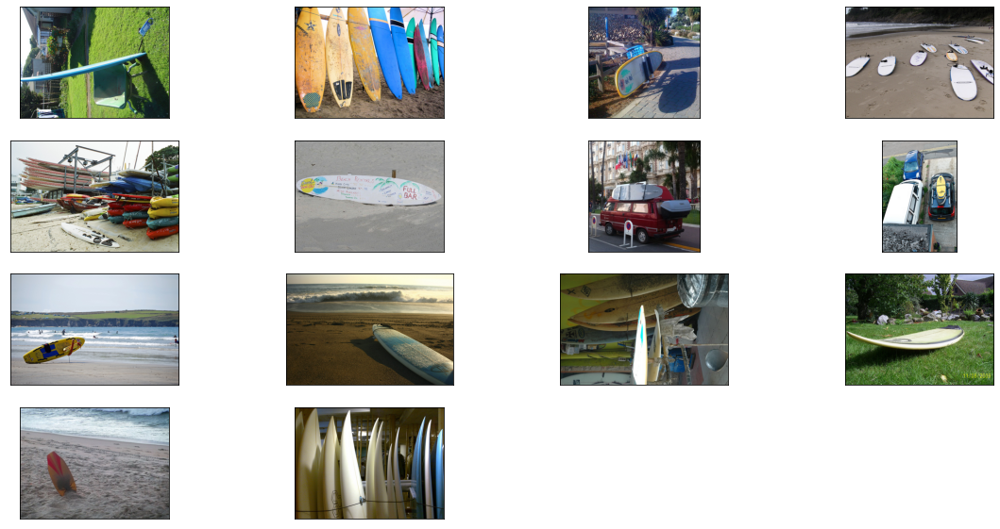

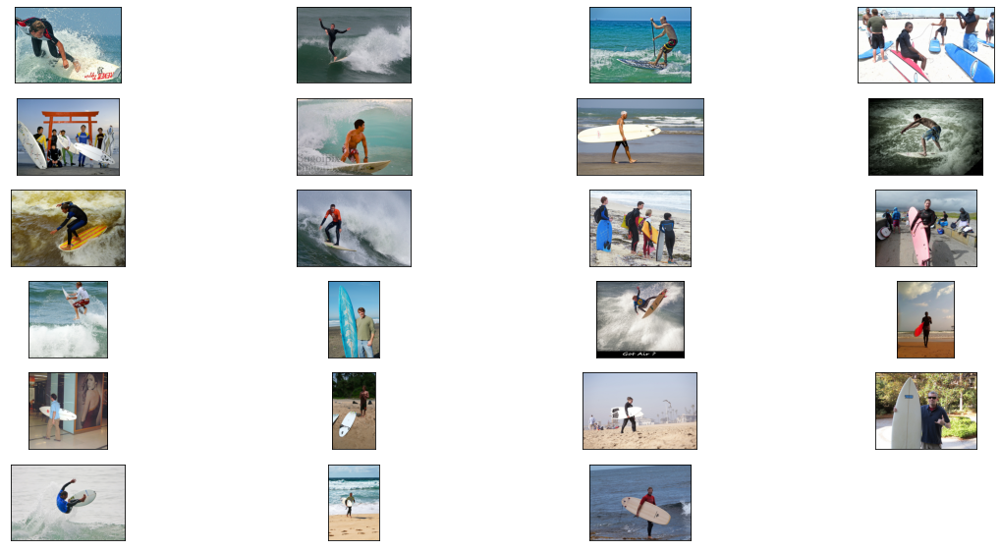

...

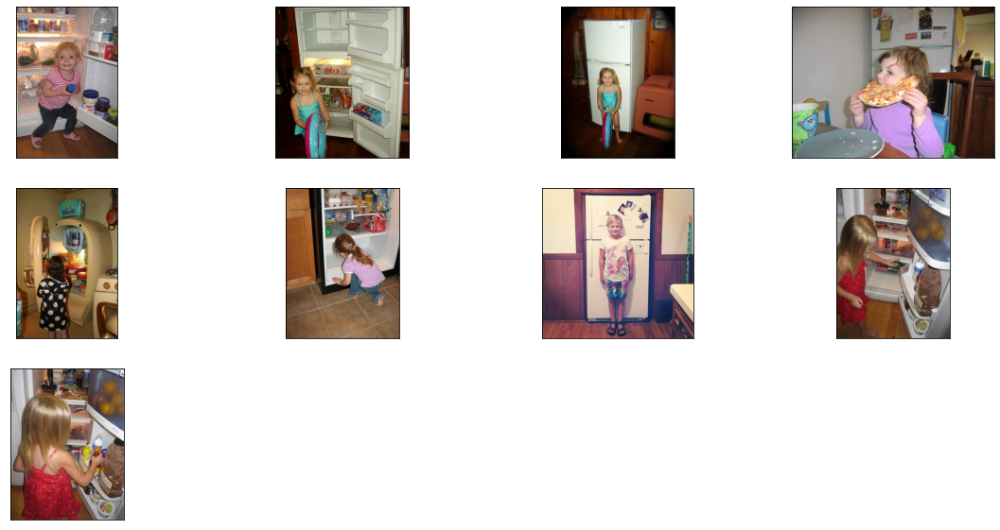

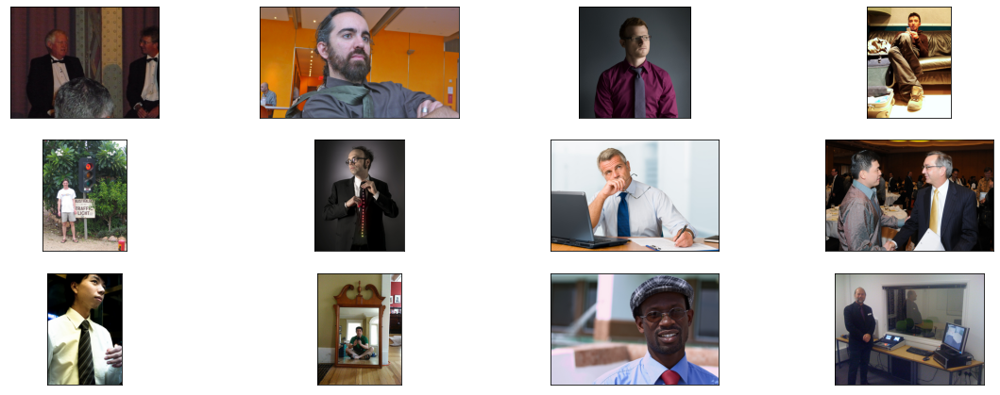

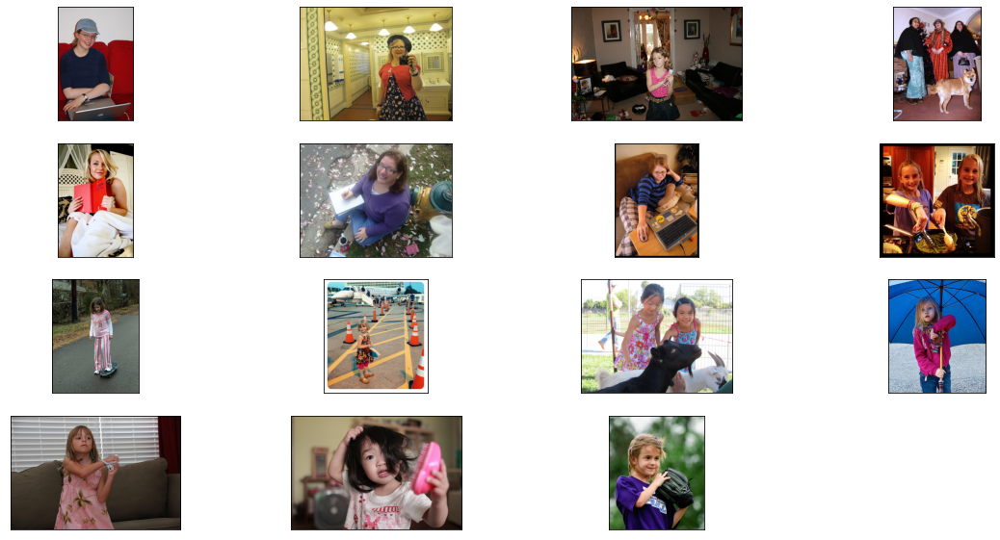

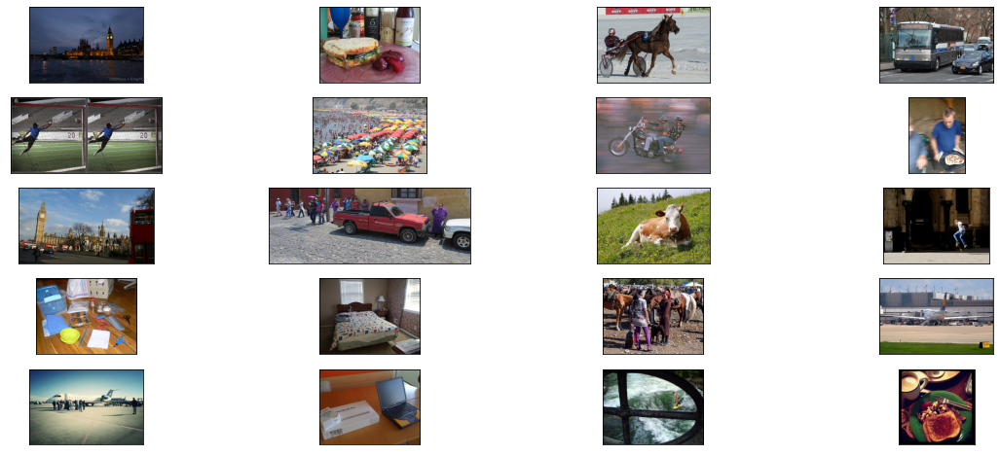

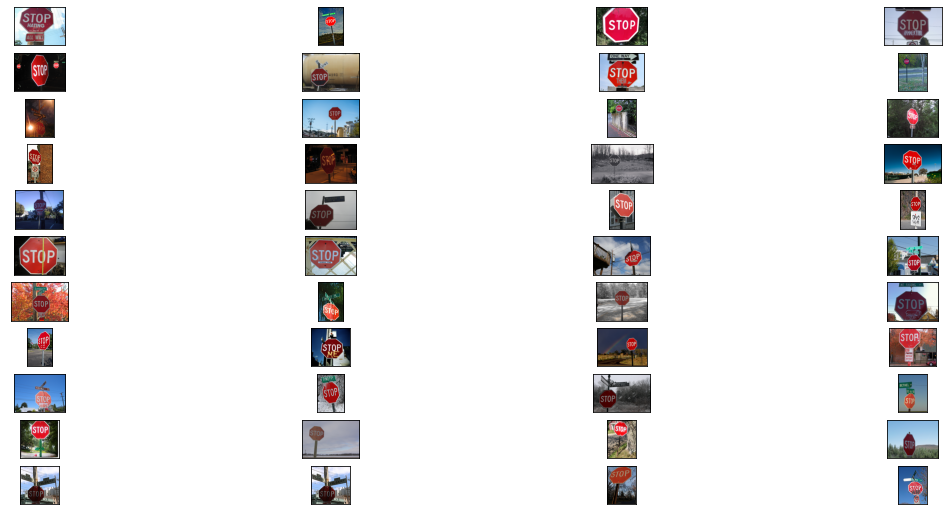

In [47]:
plot_coco('coco_test/car.txt')
plot_coco('coco_test/car_man.txt')
plot_coco('coco_test/car_woman.txt')

plot_coco('coco_test/surfboard.txt')
plot_coco('coco_test/surfboard_man.txt')
plot_coco('coco_test/surfboard_woman.txt')

plot_coco('coco_test/refrigerator.txt')
plot_coco('coco_test/refrigerator_man.txt')
plot_coco('coco_test/refrigerator_woman.txt')

plot_coco('coco_test/man.txt')
plot_coco('coco_test/woman.txt')
plot_coco('coco_test/random.txt')
plot_coco('coco_test/stop_sign.txt')
